In [1]:
!pip3 install opencv-python==3.4.2.17 opencv-contrib-python==3.4.2.17

In [2]:
import os

import cv2
import matplotlib.pyplot as plt
import numpy as np

In [3]:
%matplotlib inline
%config InlineBackend.figure_format='retina'

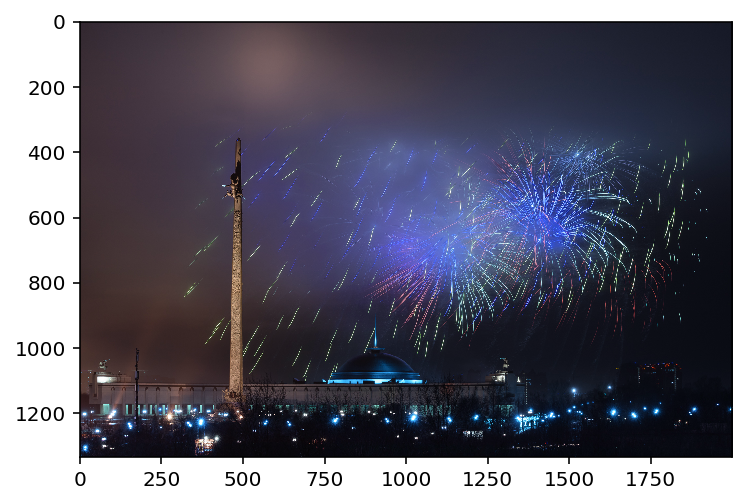

In [192]:
# open image and show with jupyter help
image_1 = cv2.imread('./res/BB3A6939.jpg')
plt.imshow(image_1)

In [193]:
# convert color scheme
rgb_image_1 = cv2.cvtColor(image_1, cv2.COLOR_BGR2RGB)

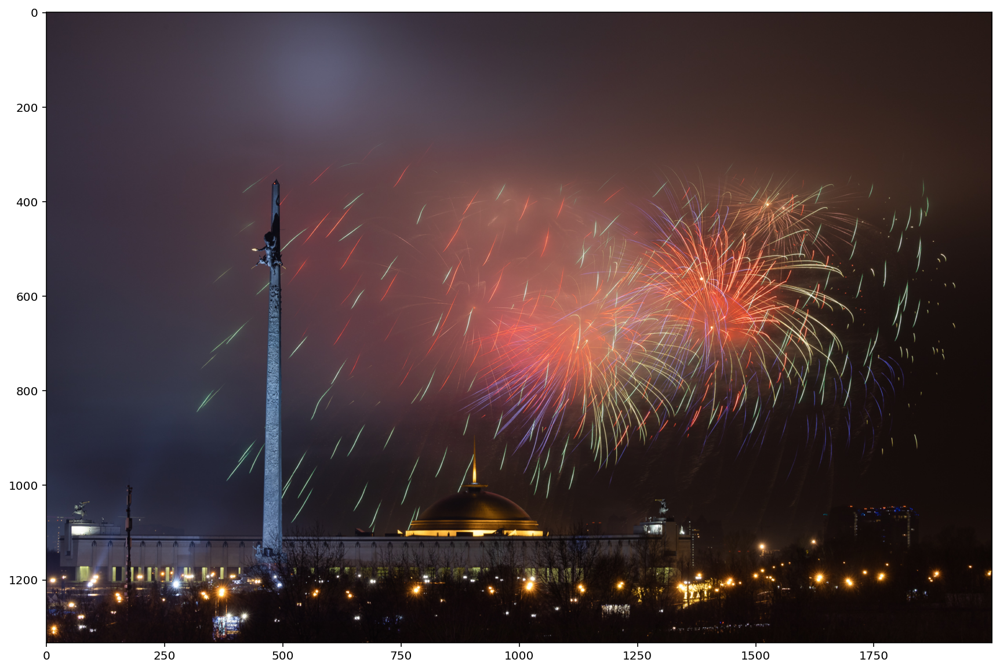

In [194]:
# open image and show with matplot help
plt.figure(figsize=(15, 10))
plt.imshow(rgb_image_1, interpolation='bilinear')
plt.show()

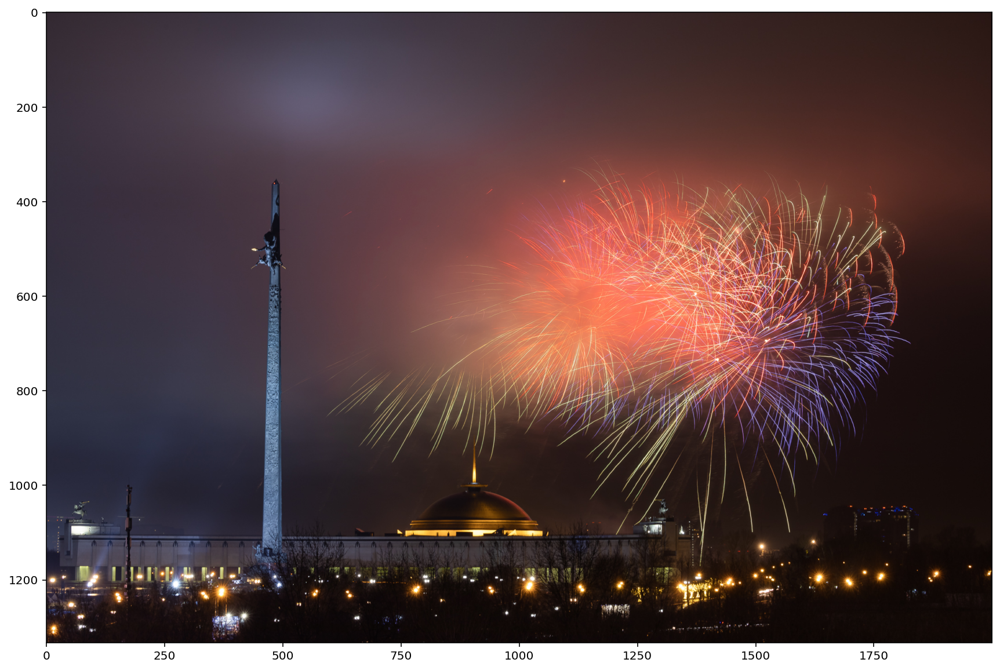

In [195]:
image_2 = cv2.imread('./res/BB3A6940.jpg')
rgb_image_2 = cv2.cvtColor(image_2, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(15, 10))
plt.imshow(rgb_image_2, interpolation='bilinear')
plt.show()

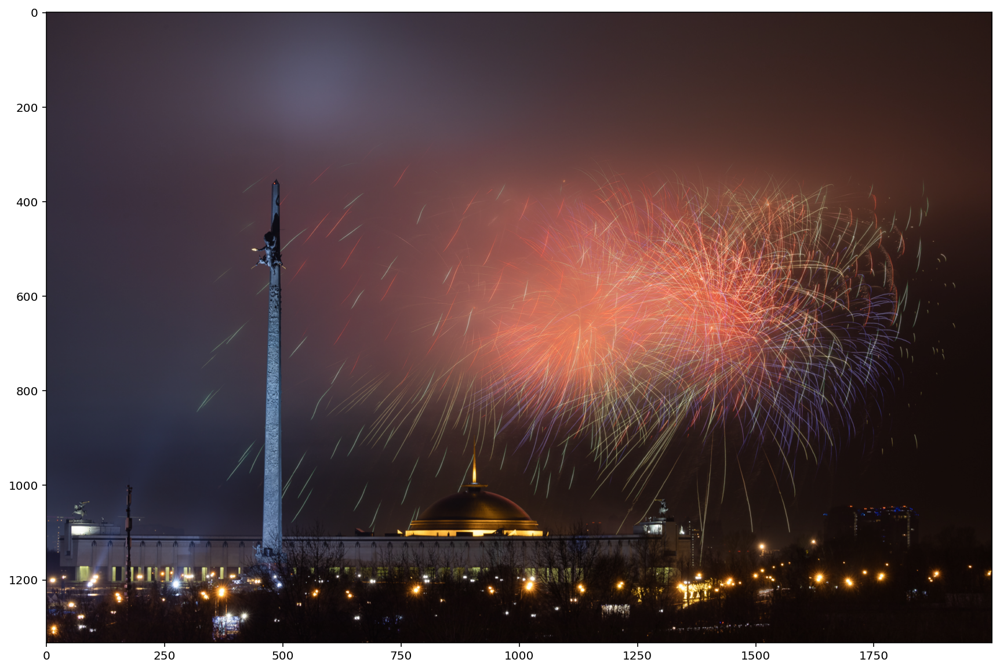

In [196]:
plt.figure(figsize=(15, 10))
plt.imshow(rgb_image_1//2 + rgb_image_2//2, interpolation='bilinear')

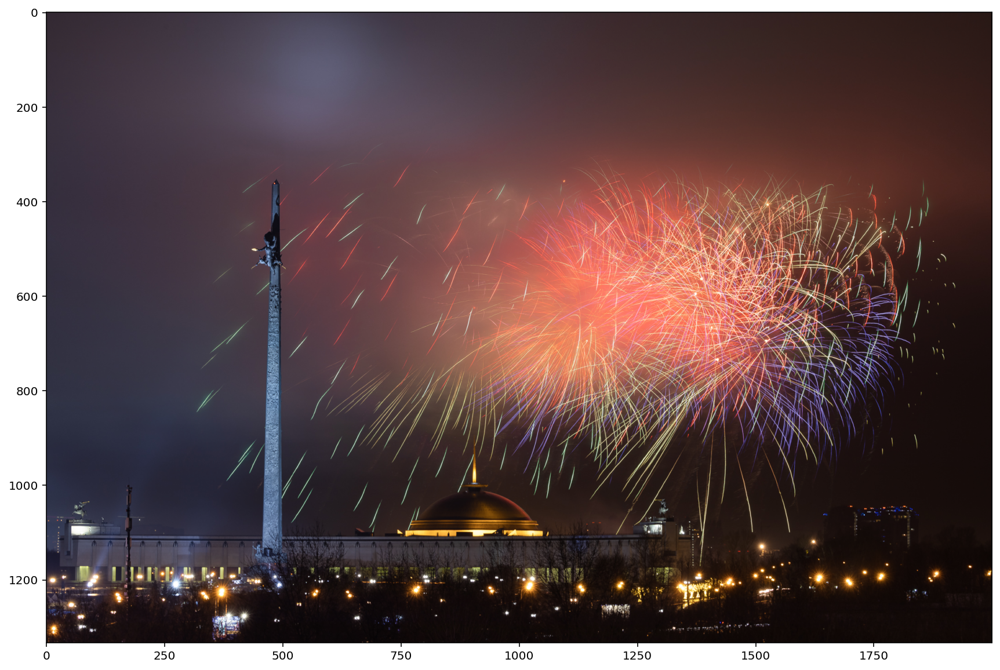

In [197]:
plt.figure(figsize=(15, 10))
plt.imshow(np.maximum(rgb_image_1, rgb_image_2), interpolation='bilinear')

In [198]:
img_arr = ['./res/'+x for x in os.listdir('./res/')]
read_im_arr = [cv2.imread(x) for x in img_arr]
rgb_img_arr = [cv2.cvtColor(x, cv2.COLOR_BGR2RGB) for x in read_im_arr]

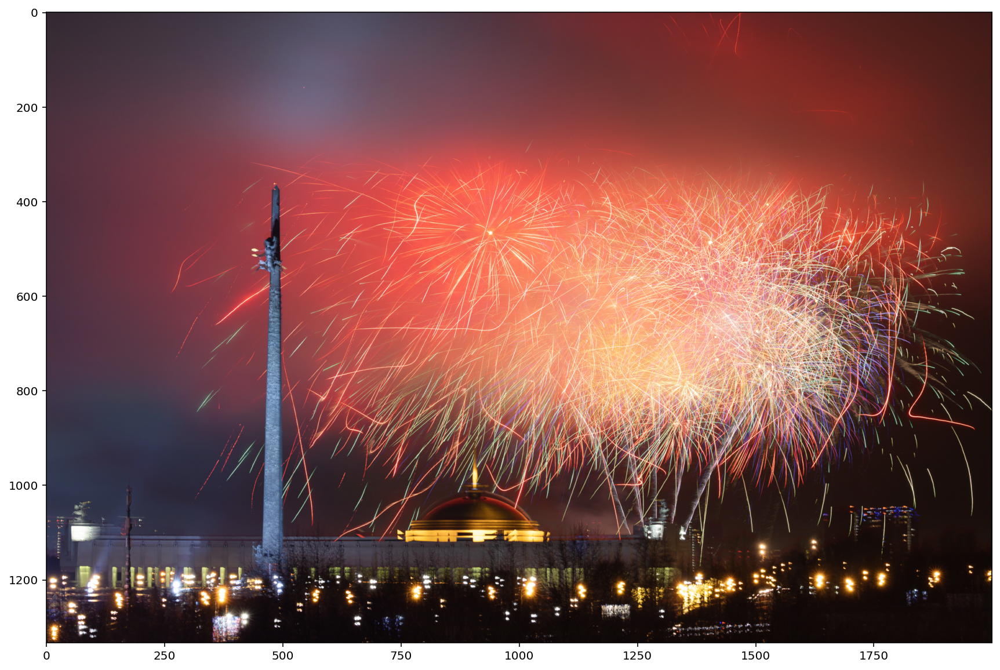

In [199]:
plt.figure(figsize=(15, 10))
# np.array(rgb_img_arr).shape
plt.imshow(np.amax(np.array(rgb_img_arr), axis=0), interpolation='bilinear')

In [12]:
img_arr_np = np.array(rgb_img_arr)

In [13]:
img_arr_np.shape

(8, 1333, 2000, 3)

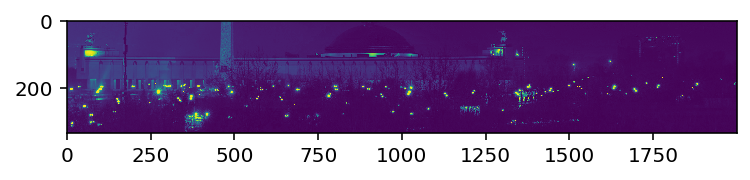

In [14]:
plt.imshow(np.amin(img_arr_np[7, 1000:, :, :], axis=2))

In [15]:
img_arr_np[7, 1000:, :, :].shape

(333, 2000, 3)

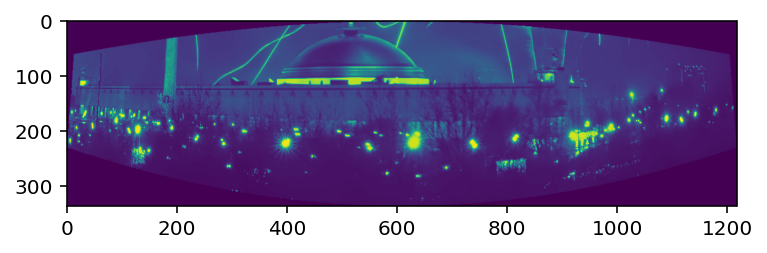

In [17]:
# initialize OpenCV's image stitcher object and then perform the image
# stitching
stitcher = cv2.createStitcher()
(status, stitched) = stitcher.stitch(img_arr_np[:, 1000:, :, :])
plt.imshow(np.amax(np.array(stitched), axis=2), interpolation='bilinear')

In [ ]:
plt.imshow(stitched)

In [229]:
def detectAndDescribe(image):
    # convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # detect and extract features from the image
    descriptor = cv2.xfeatures2d.SIFT_create()
    (kps, features) = descriptor.detectAndCompute(image, None)

    # convert the keypoints from KeyPoint objects to NumPy
    # arrays
    kps = np.float32([kp.pt for kp in kps])

    # return a tuple of keypoints and features
    return (kps, features)

In [230]:
def matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh):
    # compute the raw matches and initialize the list of actual
    # matches
    matcher = cv2.DescriptorMatcher_create("BruteForce")
    rawMatches = matcher.knnMatch(featuresA, featuresB, 2)
    matches = []

    # loop over the raw matches
    for m in rawMatches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if len(m) == 2 and m[0].distance < m[1].distance * ratio:
            matches.append((m[0].trainIdx, m[0].queryIdx))
    
    # computing a homography requires at least 4 matches
    if len(matches) > 4:
        # construct the two sets of points
        ptsA = np.float32([kpsA[i] for (_, i) in matches])
        ptsB = np.float32([kpsB[i] for (i, _) in matches])

        # compute the homography between the two sets of points
        (H, status) = cv2.findHomography(ptsA, ptsB, cv2.RANSAC, reprojThresh)

        # return the matches along with the homograpy matrix
        # and status of each matched point
        return (matches, H, status)
    # otherwise, no homograpy could be computed
    return None

In [18]:
gray = cv2.cvtColor(img_arr_np[0], cv2.COLOR_BGR2GRAY)

In [19]:
descriptor = cv2.xfeatures2d.SIFT_create()

In [27]:
(kps, features) = descriptor.detectAndCompute(gray, None)

In [30]:
k = kps[0]

(4.7323832511901855, 1246.0770263671875)

In [35]:
(kpsA, featuresA) = detectAndDescribe(img_arr_np[0])
(kpsB, featuresB) = detectAndDescribe(img_arr_np[1])

In [53]:
ratio = 0.75
reprojThresh = 4
# match features between the two images
M = matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh)

In [55]:
(matches, H, status) = M

In [69]:
status.sum()

1023

In [74]:
dsize = (img_arr_np[0].shape[1] + img_arr_np[1].shape[1], img_arr_np[0].shape[0])

In [90]:
result = cv2.warpPerspective(img_arr_np[0], H, (img_arr_np[0].shape[1], img_arr_np[0].shape[0]))

In [96]:
result[0:img_arr_np[1].shape[0], 0:img_arr_np[1].shape[1]] = img_arr_np[1]

In [100]:
(img_arr_np[1].shape[0], img_arr_np[1].shape[1])

(1333, 2000)

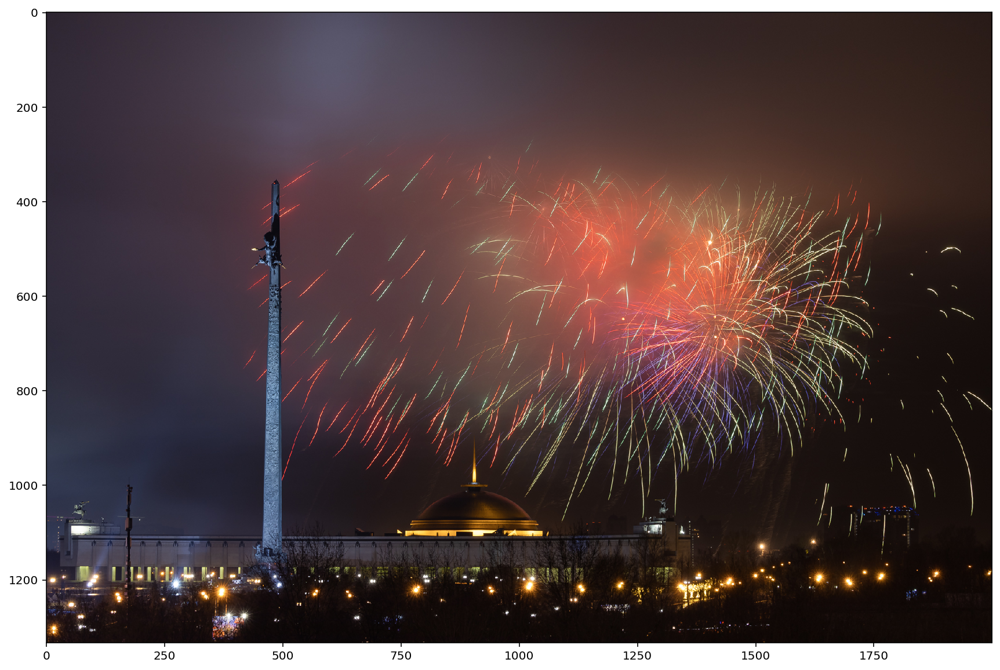

In [93]:
plt.figure(figsize=(15, 10))
plt.imshow(img_arr_np[0])
plt.show()

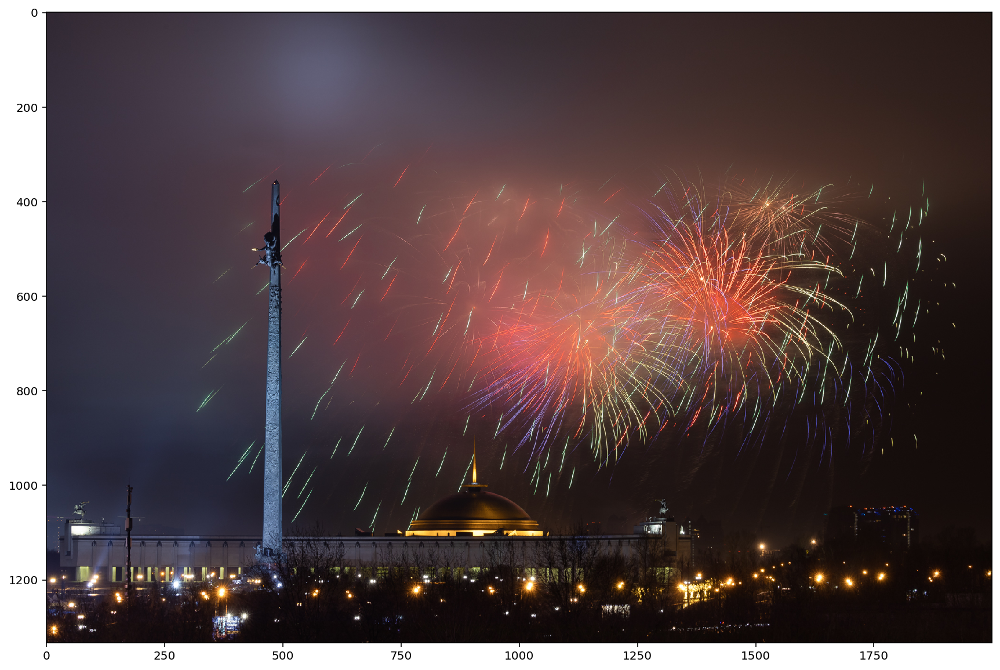

In [94]:
plt.figure(figsize=(15, 10))
plt.imshow(img_arr_np[1])
plt.show()

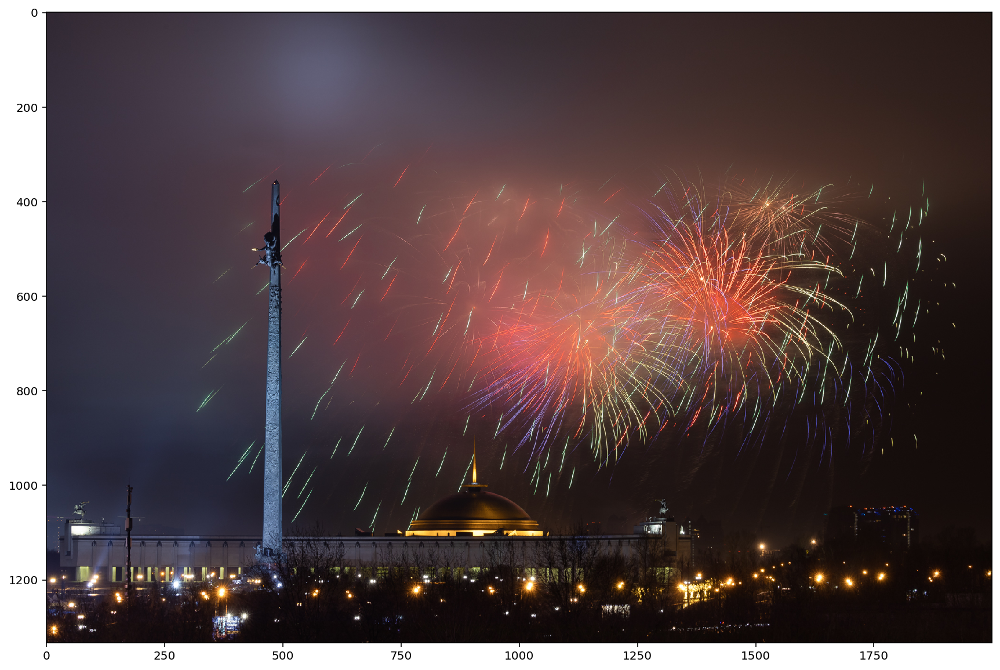

In [97]:
plt.figure(figsize=(15, 10))
plt.imshow(result)
plt.show()

In [101]:
def drawMatches(imageA, imageB, kpsA, kpsB, matches, status):
    # initialize the output visualization image
    (hA, wA) = imageA.shape[:2]
    (hB, wB) = imageB.shape[:2]
    vis = np.zeros((max(hA, hB), wA + wB, 3), dtype="uint8")
    vis[0:hA, 0:wA] = imageA
    vis[0:hB, wA:] = imageB

    # loop over the matches
    for ((trainIdx, queryIdx), s) in zip(matches, status):
        # only process the match if the keypoint was successfully
        # matched
        if s == 1:
            # draw the match
            ptA = (int(kpsA[queryIdx][0]), int(kpsA[queryIdx][1]))
            ptB = (int(kpsB[trainIdx][0]) + wA, int(kpsB[trainIdx][1]))
            cv2.line(vis, ptA, ptB, (0, 255, 0), 1)

    # return the visualization
    return vis

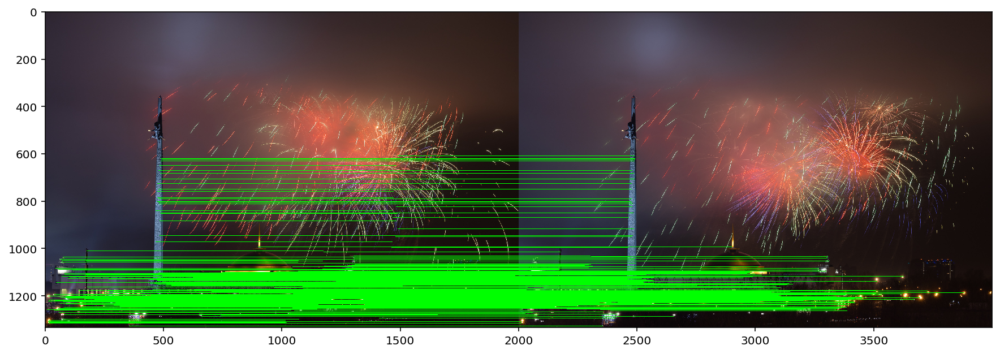

In [105]:
plt.figure(figsize=(15, 10))
plt.imshow(drawMatches(img_arr_np[0], img_arr_np[1], kpsA, kpsB, matches, status))
plt.show()

In [206]:
path = './res/'
rgb_img_arr = list(reversed([cv2.cvtColor(cv2.imread(path + x), cv2.COLOR_BGR2RGB) for x in os.listdir(path)]))

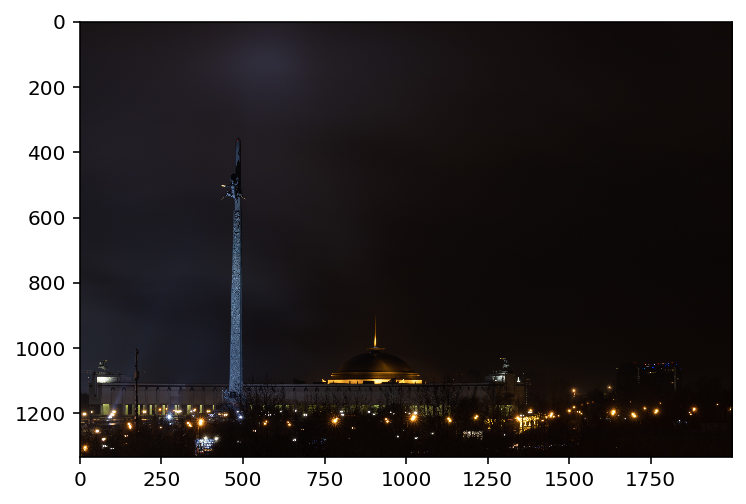

In [207]:
plt.imshow(rgb_img_arr[0])

In [280]:
import copy

In [284]:
imgA = img_arr_np[3]
imgB = img_arr_np[4]

In [285]:
def getMatches(imgA, imgB, drawmatches=False):
    img_arr_np = np.array(rgb_img_arr)
    (kpsA, featuresA) = detectAndDescribe(imgA)
    (kpsB, featuresB) = detectAndDescribe(imgB)

    ratio = 0.75
    reprojThresh = 4
    # match features between the two images
    M = matchKeypoints(kpsA, kpsB, featuresA, featuresB, ratio, reprojThresh)

    (matches, H, status) = M
    
    if drawmatches:
        plt.figure(figsize=(15, 10))
        plt.imshow(drawMatches(imgA, imgB, kpsA, kpsB, matches, status), interpolation='bilinear')
        plt.show()
        
    return M

In [286]:
def stitch(imgA, imgB):
    matches, H, status = getMatches(imgA, imgB, 1)
    
    result = cv2.warpPerspective(imgA, H, (imgA.shape[1] + imgB.shape[1], imgA.shape[0]))
    #result[0:img_arr_np[1].shape[0], 0:img_arr_np[1].shape[1]] = img_arr_np[1]
   
    i1 = copy.deepcopy(result)
    plot_imgs([i1, imgB])
    i2 = result
    i2[0:imgB.shape[0], 0:imgB.shape[1]] = imgB
    
    plot_imgs([i1, i2])
    r = np.amax(np.array([i1, i2]), axis=0)
    return r

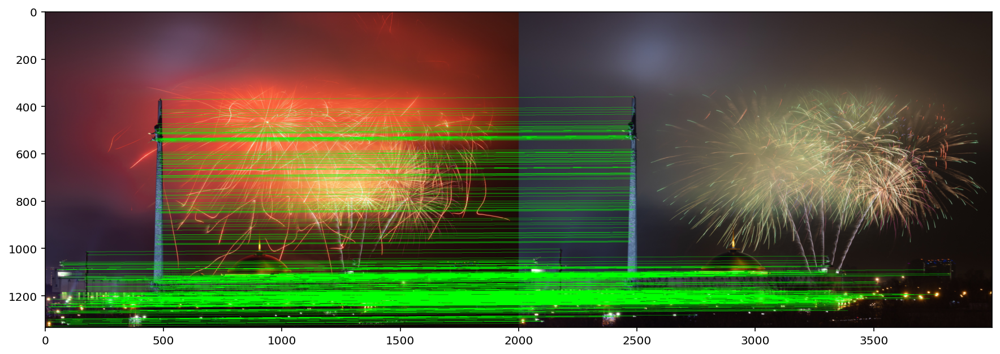

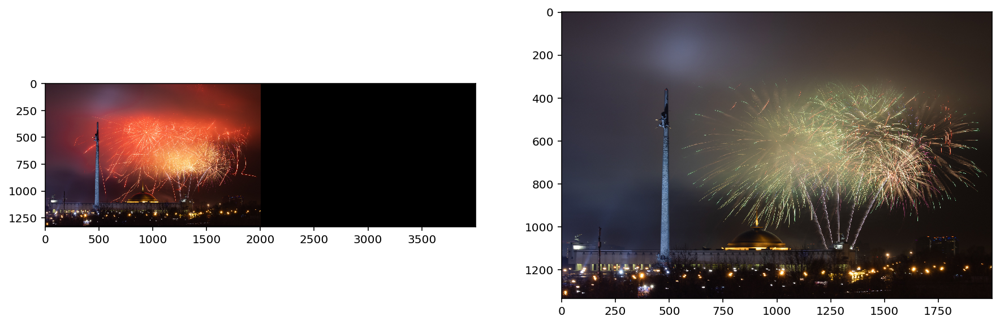

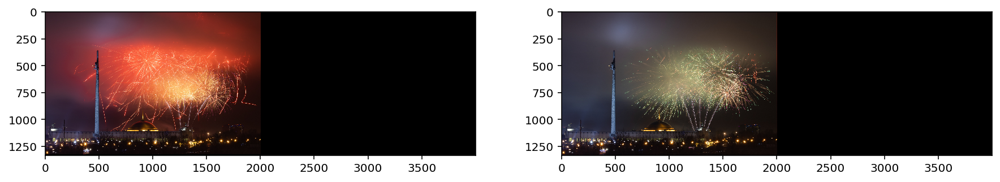

In [287]:
res = stitch(imgA, imgB)

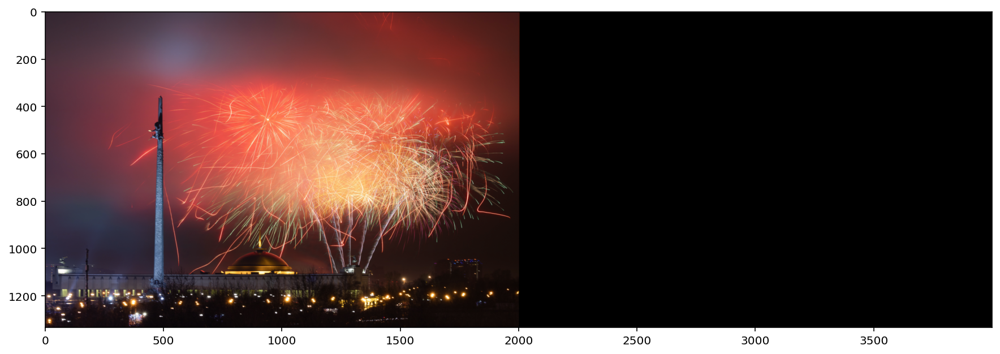

In [288]:
plt.figure(figsize=(15, 10))
plt.imshow(res, interpolation='bilinear')
plt.show()

In [289]:
def plot_imgs(imgs):
    fig, ax = plt.subplots(1, len(imgs), figsize=(15, 10))
    for i in range(len(imgs)):
        ax[i].imshow(imgs[i])
    plt.show()

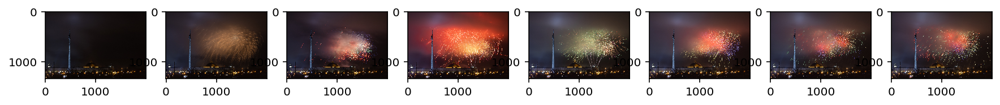

In [251]:
plot_imgs(img_arr_np)

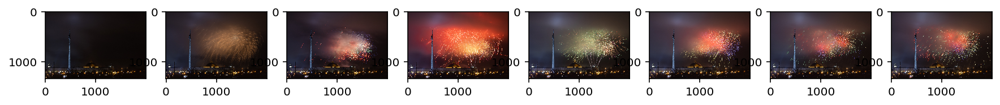

In [210]:
fig, ax = plt.subplots(1, img_arr_np.shape[0], figsize=(15, 10))
for i in range(img_arr_np.shape[0]):
    ax[i].imshow(img_arr_np[i])
plt.show()

In [211]:
stitcher = cv2.createStitcher()
(status, stitched) = stitcher.stitch(rgb_img_arr)

In [212]:
status

3

In [213]:
stitched

TypeError: Image data of dtype object cannot be converted to float

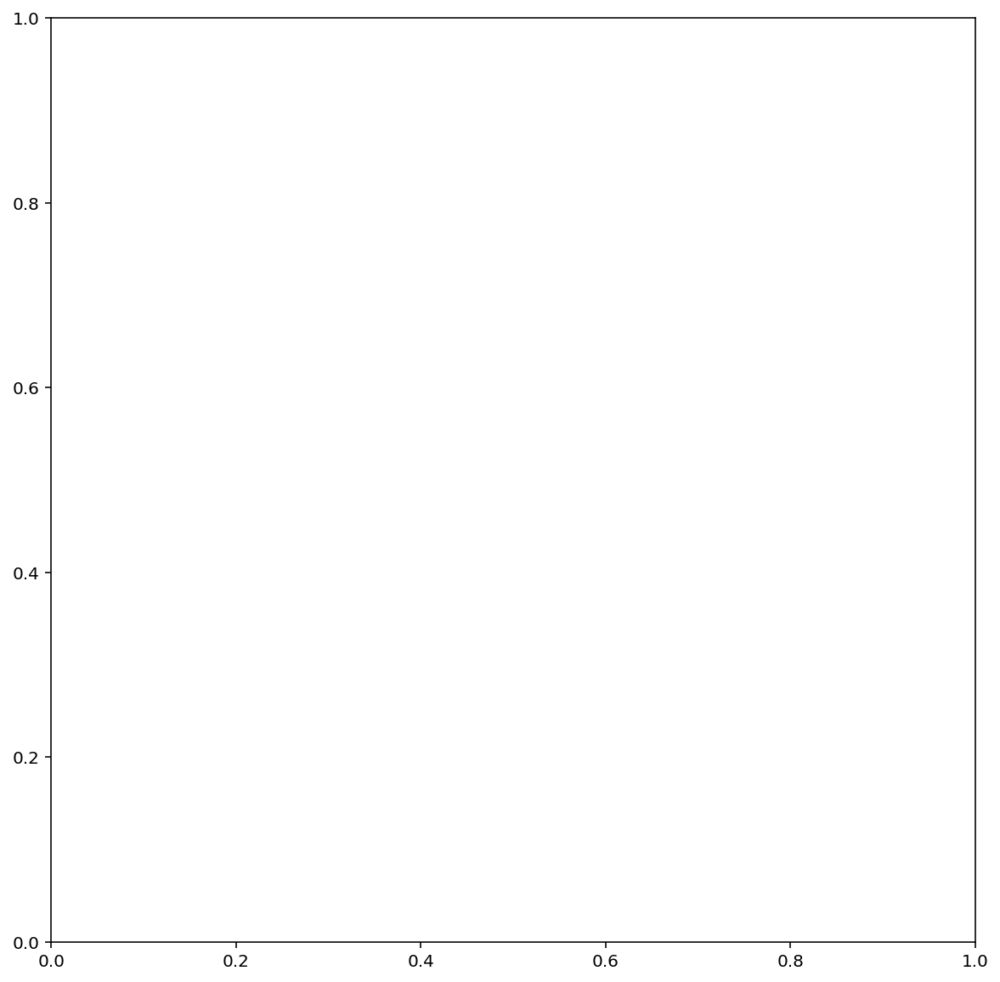

In [214]:
plt.figure(figsize=(15, 10))
plt.imshow(stitched)
plt.show()

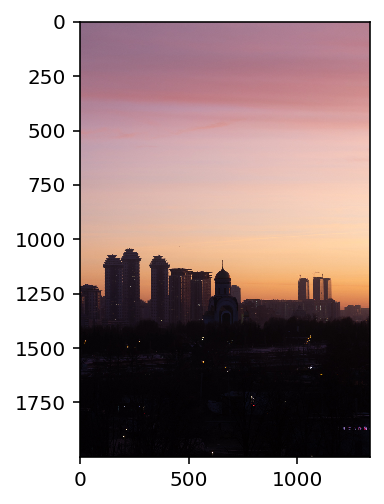

In [160]:
plt.imshow(img_arr_np[1])